<a href="https://colab.research.google.com/github/ravi1718/Gen-AI/blob/main/GenAi1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q -U google-generativeai

Import Packages

In [7]:
import google.generativeai as genai
import pathlib
import textwrap
from IPython.display import display
from IPython.display import Markdown

In [32]:
def to_markdown(text):
  text = text.replace('•', '  *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))


# Example usage:
input_text = "This is a • sample text with bullet points."
result = to_markdown(input_text)

display(result)

> This is a   * sample text with bullet points.

Set up your API Key


In [35]:
from google.colab import userdata

In [36]:
GOOGLE_API_KEY = userdata.get('GOOGLE_API_KEY')

In [37]:
genai.configure(api_key=GOOGLE_API_KEY)

In [38]:
for models in genai.list_models():
  print(models)

Model(name='models/chat-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 Chat (Legacy)',
      description='A legacy text-only model optimized for chat conversations',
      input_token_limit=4096,
      output_token_limit=1024,
      supported_generation_methods=['generateMessage', 'countMessageTokens'],
      temperature=0.25,
      max_temperature=None,
      top_p=0.95,
      top_k=40)
Model(name='models/text-bison-001',
      base_model_id='',
      version='001',
      display_name='PaLM 2 (Legacy)',
      description='A legacy model that understands text and generates text as an output',
      input_token_limit=8196,
      output_token_limit=1024,
      supported_generation_methods=['generateText', 'countTextTokens', 'createTunedTextModel'],
      temperature=0.7,
      max_temperature=None,
      top_p=0.95,
      top_k=40)
Model(name='models/embedding-gecko-001',
      base_model_id='',
      version='001',
      display_name='Embedding Gecko

In [40]:
for models in genai.list_models():
  if 'generateContent' in models.supported_generation_methods:
    print(models.name)

models/gemini-1.0-pro-vision-latest
models/gemini-pro-vision
models/gemini-1.5-pro-latest
models/gemini-1.5-pro-001
models/gemini-1.5-pro-002
models/gemini-1.5-pro
models/gemini-1.5-flash-latest
models/gemini-1.5-flash-001
models/gemini-1.5-flash-001-tuning
models/gemini-1.5-flash
models/gemini-1.5-flash-002
models/gemini-1.5-flash-8b
models/gemini-1.5-flash-8b-001
models/gemini-1.5-flash-8b-latest
models/gemini-1.5-flash-8b-exp-0827
models/gemini-1.5-flash-8b-exp-0924
models/gemini-2.5-pro-exp-03-25
models/gemini-2.5-pro-preview-03-25
models/gemini-2.0-flash-exp
models/gemini-2.0-flash
models/gemini-2.0-flash-001
models/gemini-2.0-flash-exp-image-generation
models/gemini-2.0-flash-lite-001
models/gemini-2.0-flash-lite
models/gemini-2.0-flash-lite-preview-02-05
models/gemini-2.0-flash-lite-preview
models/gemini-2.0-pro-exp
models/gemini-2.0-pro-exp-02-05
models/gemini-exp-1206
models/gemini-2.0-flash-thinking-exp-01-21
models/gemini-2.0-flash-thinking-exp
models/gemini-2.0-flash-thinki

Generate text from text inputs (Text to Text model)

In [60]:
model = genai.GenerativeModel('gemini-2.0-flash')

In [64]:
%%time
response = model.generate_content("What is the meaning of life")

CPU times: user 34.1 ms, sys: 4.84 ms, total: 39 ms
Wall time: 6.01 s


In [65]:
to_markdown(response.text)

> Ah, the big question! The meaning of life is one of those things that philosophers, theologians, and individuals have pondered for centuries. There's no single, universally accepted answer, which is both frustrating and liberating. Here's a breakdown of different perspectives:
> 
> **1. Philosophical Perspectives:**
> 
> *   **Nihilism:**  The belief that life is inherently without meaning, purpose, or intrinsic value.  There's no objective meaning, and we're free to create our own.
> *   **Existentialism:**  We are born into a meaningless universe, but we are free to define our own essence through our choices and actions.  Emphasis on personal responsibility and creating meaning.  Key figures include Sartre and Camus.
> *   **Absurdism:** Acknowledges the inherent conflict between our desire to find meaning and the meaningless universe. We should embrace the absurdity and revolt against it through our choices and actions.
> *   **Hedonism:** The pursuit of pleasure and avoidance of pain is the ultimate goal and defines the meaning of life.
> *   **Utilitarianism:**  Maximizing happiness and well-being for the greatest number of people is the guiding principle.
> *   **Stoicism:** Finding meaning through virtue, reason, and acceptance of what we cannot control. Focus on inner peace and living in accordance with nature.
> *   **Humanism:** Emphasizes human reason, ethics, and values. Finding meaning in contributing to human flourishing and progress.
> 
> **2. Religious and Spiritual Perspectives:**
> 
> *   **Theistic Religions (Christianity, Islam, Judaism, Hinduism, etc.):** Life has meaning ordained by a higher power. This often involves serving God, following divine commandments, and striving for spiritual enlightenment or salvation. The meaning is usually tied to an afterlife or a higher purpose beyond earthly existence.
> *   **Buddhism:** Finding meaning through the pursuit of enlightenment and liberation from suffering (Nirvana). This involves understanding the nature of reality, practicing mindfulness, and cultivating compassion.
> 
> **3. Psychological Perspectives:**
> 
> *   **Purpose and Goals:**  Finding meaning by setting goals, pursuing passions, and contributing to something larger than oneself.  Having a sense of purpose can lead to greater well-being.
> *   **Relationships and Connection:**  Building meaningful relationships with others and experiencing love, connection, and belonging.
> *   **Self-Actualization (Maslow):**  Realizing one's full potential and living authentically.  This involves personal growth, creativity, and contributing to society.
> *   **Meaning-Making:**  The active process of constructing meaning from our experiences, even in the face of adversity.  This involves finding value, significance, and coherence in our lives.
> 
> **4. Biological Perspective:**
> 
> *   From a purely biological standpoint, the "meaning" of life is survival and reproduction. This perspective emphasizes the propagation of genes and the continuation of the species.
> 
> **Key Considerations:**
> 
> *   **Subjectivity:** The meaning of life is often a deeply personal and subjective experience. What gives one person meaning may not resonate with another.
> *   **Evolving Meaning:** Our sense of meaning can change over time as we grow, learn, and experience life's ups and downs.
> *   **Action vs. Contemplation:**  Some believe meaning is found through action and engagement with the world, while others believe it's found through introspection and contemplation.
> *   **The Search Itself:**  The very act of searching for meaning can be meaningful.
> 
> **So, what does it all mean?**
> 
> Ultimately, the meaning of life is what *you* choose to make it. It's not a destination but a journey. Consider what resonates with you:
> 
> *   What values are important to you?
> *   What activities make you feel alive and engaged?
> *   What kind of impact do you want to have on the world?
> *   What relationships do you cherish?
> 
> By reflecting on these questions, you can begin to craft your own personal meaning of life. It's an ongoing process of discovery and creation. Good luck on your search!


In [66]:
response.candidates

[content {
  parts {
    text: "Ah, the big question! The meaning of life is one of those things that philosophers, theologians, and individuals have pondered for centuries. There\'s no single, universally accepted answer, which is both frustrating and liberating. Here\'s a breakdown of different perspectives:\n\n**1. Philosophical Perspectives:**\n\n*   **Nihilism:**  The belief that life is inherently without meaning, purpose, or intrinsic value.  There\'s no objective meaning, and we\'re free to create our own.\n*   **Existentialism:**  We are born into a meaningless universe, but we are free to define our own essence through our choices and actions.  Emphasis on personal responsibility and creating meaning.  Key figures include Sartre and Camus.\n*   **Absurdism:** Acknowledges the inherent conflict between our desire to find meaning and the meaningless universe. We should embrace the absurdity and revolt against it through our choices and actions.\n*   **Hedonism:** The pursuit of

In [67]:
response.prompt_feedback

In [70]:
%%time
response = model.generate_content("What is the meaning of life?", stream=True)
for chunk in response:
  print(chunk.text)
  print("_"*80)

Ah
________________________________________________________________________________
, the million-dollar question! The meaning of life is one of those profound
________________________________________________________________________________
 questions that philosophers, theologians, and individuals have pondered for centuries. The truth is, there'
________________________________________________________________________________
s no single, universally accepted answer.  Instead, the meaning of life is often considered:

*   **Subjective and Personal:** Many believe that meaning
________________________________________________________________________________
 is not inherent in the universe, but rather something we create for ourselves. It's based on our individual values, beliefs, experiences, and goals. What
________________________________________________________________________________
 gives one person's life meaning might be completely different for another.

*   **Something to be 

In [71]:
!curl -o image.jpg https://images.unsplash.com/photo-1575936123452-b67c3203c357?fm=jpg&q=60&w=3000&ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxzZWFyY2h8Mnx8aW1hZ2V8ZW58MHx8MHx8fDA%3D

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 3180k  100 3180k    0     0  8731k      0 --:--:-- --:--:-- --:--:-- 8737k


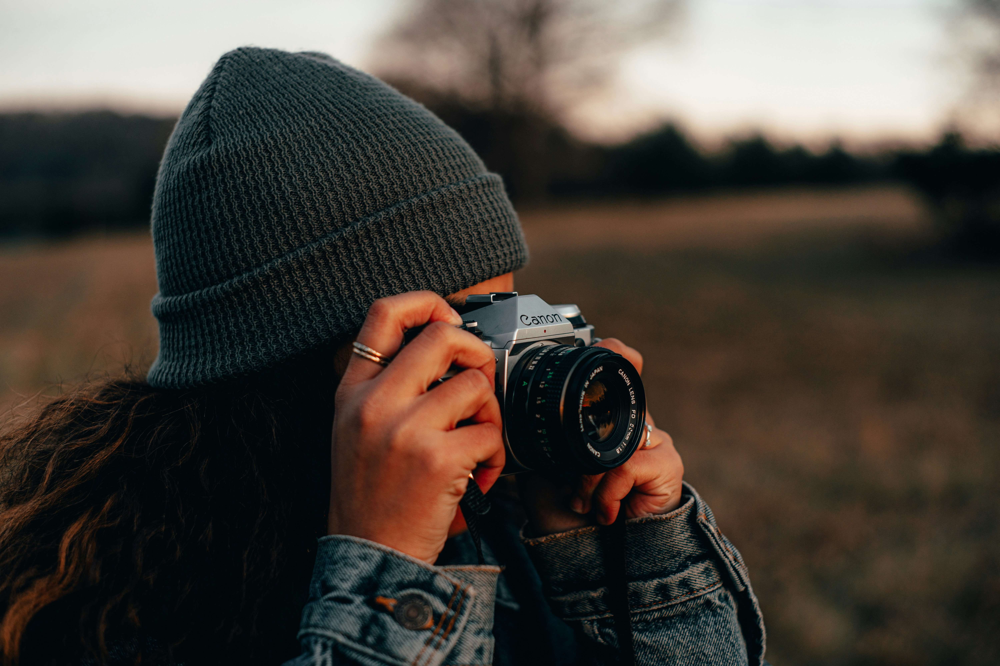

In [72]:
import PIL.Image

img = PIL.Image.open('image.jpg')
img

In [75]:
model2 = genai.GenerativeModel('gemini-1.5-flash')

In [76]:
response = model2.generate_content(img)

In [78]:
to_markdown(response.text)

> Here is a description of the image:
> 
> Close-up view of a person, seemingly a young woman, wearing a dark gray knit beanie and a denim jacket. 
> 
> 
> The person is holding a vintage Canon film camera to their eye, appearing to be taking a photograph. Their hands are visible, and they are wearing rings. The focus is primarily on the camera and the person's hands, while the background is softly blurred. The background suggests a rural or outdoor setting, perhaps a field or meadow, with trees and a hazy sky in the distance. The lighting suggests it might be late afternoon or early evening, with soft, warm light. The overall mood is serene and contemplative.
